In [1]:
# common 
import sys
import os
import os.path as op

# basic 
import xarray as xr
import numpy as np
import pandas as pd
from datetime import timedelta as td
from matplotlib import pyplot as plt
from pandas.plotting import register_matplotlib_converters

# interactive
from ipywidgets import interactive

# advanced
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
import dash  # (version 1.12.0) pip install dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output

# warnings
import warnings
warnings.filterwarnings("ignore")

# dev library 
sys.path.insert(0, os.getcwd())

# RBF module 
from slopes import Slopes_SOM
from slopes import consult

In [2]:
# pip renders for jupyter book
import plotly.io as pio
pio.renderers.default = "notebook"

In [3]:
# load the data
data = pd.read_pickle(op.join(os.getcwd(), '..', 'data', 'reconstructed', 
                              'surfbreaks_reconstructed_final.pkl'))
data['Index'] = data['Index'].where(data['Index']<1, 1) * 10
data = data.dropna(how='any', axis=0)

data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1008091 entries, 1979-02-01 02:00:00 to 2020-02-29 20:00:00
Data columns (total 27 columns):
 #   Column           Non-Null Count    Dtype  
---  ------           --------------    -----  
 0   Hs               1008091 non-null  float64
 1   Tp               1008091 non-null  float64
 2   Dir              1008091 non-null  float64
 3   Spr              1008091 non-null  float64
 4   W                1008091 non-null  float64
 5   DirW             1008091 non-null  float64
 6   DDir             1008091 non-null  float64
 7   DDirW            1008091 non-null  float64
 8   ocean_tide       1008091 non-null  float64
 9   Omega            1008091 non-null  float64
 10  H_break          1008091 non-null  float64
 11  DDir_R           1008091 non-null  float64
 12  Slope            1008091 non-null  float64
 13  Iribarren        1008091 non-null  float64
 14  Hb_index         1008091 non-null  float64
 15  Tp_index         1008091 non-null

<AxesSubplot:>

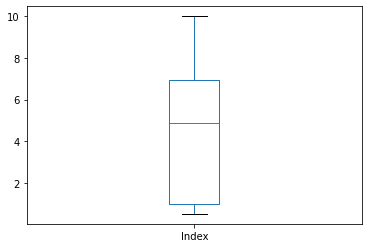

In [4]:
data.Index.plot.box()

<AxesSubplot:>

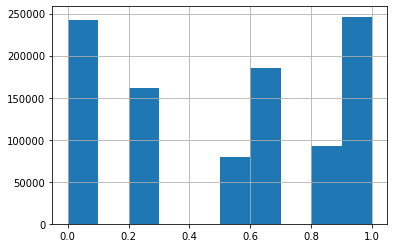

In [5]:
data.Hb_index.hist()

<AxesSubplot:>

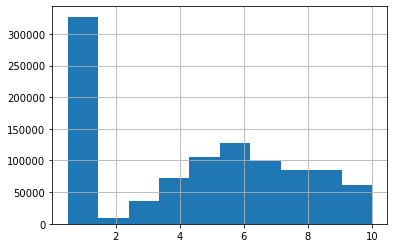

In [6]:
data.Index.hist()

In [7]:
consult(data=data,
        beaches=['segunda', 'laredo', 'forta'],
        day='2017-01-13',
        columns=['H_break', 'Hb_index', 'Index'])

,H_break,Hb_index,Index,beach
2017-01-13 03:00:00,3.857180,0.3,3.376,segunda
2017-01-13 08:00:00,3.926694,0.3,2.532,segunda
2017-01-13 13:00:00,3.804837,0.3,3.376,segunda
2017-01-13 18:00:00,4.560021,0.0,1.000,segunda
2017-01-13 23:00:00,3.389903,0.5,5.088,segunda
2017-01-13 03:00:00,3.747338,0.3,2.664,laredo
2017-01-13 08:00:00,3.819149,0.3,2.664,laredo
2017-01-13 13:00:00,3.717768,0.5,4.384,laredo
2017-01-13 18:00:00,4.273107,0.3,3.776,laredo
2017-01-13 23:00:00,3.435028,0.5,4.608,laredo


In [8]:
consult(data=data,
        beaches=['segunda', 'laredo', 'forta'],
        day='2019-12-22',
        columns=['H_break', 'Hb_index', 'Index'])

,H_break,Hb_index,Index,beach
2019-12-22 01:00:00,3.646619,0.5,4.320,segunda
2019-12-22 06:00:00,3.164886,0.5,4.860,segunda
2019-12-22 11:00:00,2.948261,0.8,6.264,segunda
2019-12-22 16:00:00,3.183460,0.5,4.320,segunda
2019-12-22 21:00:00,2.933703,0.8,5.856,segunda
2019-12-22 01:00:00,3.782744,0.3,3.664,laredo
2019-12-22 06:00:00,3.431986,0.5,5.382,laredo
2019-12-22 11:00:00,3.289403,0.5,5.058,laredo
2019-12-22 16:00:00,3.717900,0.5,4.496,laredo
2019-12-22 21:00:00,3.537950,0.5,4.976,laredo


In [9]:
consult(data=data,
        beaches=['brusco', 'canallave', 'laredo'],
        day='2003-06-20',
        columns=['H_break', 'Hb_index', 'Index'])

,H_break,Hb_index,Index,beach
2003-06-20 02:00:00,2.131825,1.0,6.798,canallave
2003-06-20 07:00:00,1.979701,1.0,5.168,canallave
2003-06-20 12:00:00,2.064915,1.0,5.168,canallave
2003-06-20 17:00:00,2.103380,1.0,1.000,canallave
2003-06-20 22:00:00,1.854655,1.0,7.106,canallave
2003-06-20 02:00:00,1.792632,1.0,6.886,brusco
2003-06-20 07:00:00,1.678462,0.7,3.472,brusco
2003-06-20 12:00:00,1.858943,1.0,1.000,brusco
2003-06-20 17:00:00,1.997746,1.0,1.000,brusco
2003-06-20 22:00:00,1.703752,1.0,1.000,brusco


In [10]:
def plot_scatter(x, y):
    fig = px.scatter(data[::100], x=x, y=y, color='beach')
    fig.show()

interactive_plot = interactive(plot_scatter, 
                               x=data.columns,
                               y=data.columns)
interactive_plot

interactive(children=(Dropdown(description='x', options=('Hs', 'Tp', 'Dir', 'Spr', 'W', 'DirW', 'DDir', 'DDirW…

In [11]:
def plot_bar(grouper, variable):
    fig = px.bar(data.groupby([grouper, 'beach']).mean().reset_index(),
                 y=variable,
                 x=grouper,
                 color='beach',
                 barmode='group')
    fig.show()

interactive_plot = interactive(plot_bar, 
                               grouper=['Hour', 'Day_Moment', 'Month', 'Season', 'Year'],
                               variable=data.columns)
interactive_plot

interactive(children=(Dropdown(description='grouper', options=('Hour', 'Day_Moment', 'Month', 'Season', 'Year'…

In [12]:
def plot_box(period, y):
    data_box = data.copy()
    if isinstance(period, np.int64):
        fig = px.box(data_box.where(data_box['Month']==period).dropna(how='all', axis=0), 
                     x='beach', y=y, title='Month: '+str(period))
    elif period=='all':
        fig = px.box(data_box, x='beach', y=y, title='Points: '+period)
    elif period in ['Winter', 'Spring', 'Summer', 'Autumn']:
        fig = px.box(data_box.where(data_box['Season']==period).dropna(how='all', axis=0), 
                     x='beach', y=y, title='Season: '+period)
    else:
        fig = px.box(data_box.where(data_box['Day_Moment']==period).dropna(how='all', axis=0), 
                     x='beach', y=y, title='Day moment: '+period)
    fig.show()
    
period = ['all'] + list(data.Season.unique()) + list(data.Month.unique()) + list(data.Day_Moment.unique())

interactive_plot = interactive(plot_box,
                               period=period,
                               y=data.columns)
interactive_plot

interactive(children=(Dropdown(description='period', options=('all', 'Winter', 'Spring', 'Summer', 'Autumn', 2…

In [13]:
def plot_hist(period, x):
    data_hist = data[::100].copy()
    if isinstance(period, np.int64):
        fig = px.histogram(data_hist.where(data_hist['Month']==period).dropna(how='all', axis=0), 
                           x=x, color='beach', marginal='box', 
                           hover_data=data.columns, title='Month: '+str(period))
    elif period=='all':
        fig = px.histogram(data_hist, 
                           x=x, color='beach', marginal='box', 
                           hover_data=data.columns, title='Points: '+period)
    elif period in ['Winter', 'Spring', 'Summer', 'Autumn']:
        fig = px.histogram(data_hist.where(data_hist['Season']==period).dropna(how='all', axis=0), 
                           x=x, color='beach', marginal='box', 
                           hover_data=data.columns, title='Season: '+period)
    else:
        fig = px.histogram(data_hist.where(data_hist['Day_Moment']==period).dropna(how='all', axis=0), 
                           x=x, color='beach', marginal='box', 
                           hover_data=data.columns, title='Day moment: '+period)
    fig.show()
    
period = ['all'] + list(data.Season.unique()) + list(data.Month.unique()) + list(data.Day_Moment.unique())

interactive_plot = interactive(plot_hist,
                               period=period,
                               x=data.columns)
interactive_plot

interactive(children=(Dropdown(description='period', options=('all', 'Winter', 'Spring', 'Summer', 'Autumn', 2…

In [14]:
def plot_prob(beach):
    histcolor = ['blue', 'green', 'yellow', 'orange', 'red', 'purple', 'black']
    data_prob = data.where(data['beach']==beach).dropna(how='all', axis=0).copy()
    data_prob = data_prob.groupby([data_prob.index.dayofyear, 
                                   pd.cut(data_prob['Index'],
                                          [0,1,3,5,7,8,9,10],
                                          right=True)])\
                .count().mean(axis=1) / (len(data_prob)/366)
    data_prob.name = 'Probability of RSI'
    fig = px.histogram(data_prob.reset_index(),
                       x='level_0', y='Probability of RSI',
                       color='Index',
                       color_discrete_map={key: value for (key, value) in zip(
                           data_prob.reset_index()['Index'].unique(),
                           histcolor)},
                       nbins=366, range_y=[0,1],
                       labels={'level_0': 'Day of year'},
                       title='Beach: ' + beach, width=900, height=400)
    fig.show()
    
interactive_plot = interactive(plot_prob,
                               beach=data.beach.unique())
interactive_plot

interactive(children=(Dropdown(description='beach', options=('farolillo', 'bederna', 'oyambre', 'locos', 'cana…

In [15]:
def plot_prob(beach, ini_year, end_year):
    histcolor = ['blue', 'green', 'yellow', 'orange', 'red', 'purple', 'black']
    data_prob = data.where(data['beach']==beach).dropna(how='all', axis=0).copy()
    data_prob = data.where((data['Year']>=ini_year) & (data['Year']<=end_year))\
                .dropna(how='all', axis=0).copy()
    data_prob = data_prob.groupby([pd.Grouper(freq='M'), 
                                   pd.cut(data_prob['Index'],
                                          [0,1,3,5,7,8,9,10],
                                          right=True)])\
                .count().mean(axis=1) / (len(data_prob)/(12*(end_year-ini_year + 1)))
    data_prob.name = 'Probability of RSI'
    fig = px.histogram(data_prob.reset_index(),
                       x='level_0', y='Probability of RSI',
                       color='Index',
                       color_discrete_map={key: value for (key, value) in zip(
                           data_prob.reset_index()['Index'].unique(),
                           histcolor)},
                       nbins=12*int(end_year-ini_year + 1), range_y=[0,1],
                       labels={'level_0': 'Historical month'},
                       title='Beach: ' + beach, width=900, height=400)
    fig.show()
    
interactive_plot = interactive(plot_prob,
                               beach=data.beach.unique(),
                               ini_year=data.Year.unique(),
                               end_year=data.Year.unique())
interactive_plot

interactive(children=(Dropdown(description='beach', options=('farolillo', 'bederna', 'oyambre', 'locos', 'cana…

In [16]:
def plot_prob_grouper(beach, grouper):
    histcolor = ['blue', 'green', 'yellow', 'orange', 'red', 'purple', 'black']
    data_prob = data.where(data['beach']==beach).dropna(how='all', axis=0).copy()
    data_prob = data_prob.groupby([data_prob[grouper], 
                                   pd.cut(data_prob['Index'],
                                          [0,1,3,5,7,8,9,10],
                                          right=True)])\
                .count().mean(axis=1) / (len(data_prob)/len(data[grouper].unique()))
    data_prob.name = 'Probability of RSI'
    fig = px.histogram(data_prob.reset_index(),
                       x=grouper, y='Probability of RSI',
                       color='Index',
                       color_discrete_map={key: value for (key, value) in zip(
                           data_prob.reset_index()['Index'].unique(),
                           histcolor)},
                       range_y=[0,1], nbins=len(data[grouper].unique()),
                       labels={'level_0': grouper},
                       title='Beach: ' + beach, width=900, height=400)
    fig.show()
    
grouper = ['Month', 'Season', 'Year']
    
interactive_plot = interactive(plot_prob_grouper,
                               beach=data.beach.unique(),
                               grouper=grouper)
interactive_plot

interactive(children=(Dropdown(description='beach', options=('farolillo', 'bederna', 'oyambre', 'locos', 'cana…

In [17]:
def plot_rose(beach):
    data_prob = data.where(data['beach']==beach).dropna(how='all', axis=0).copy()
    data_prob = data_prob.groupby([pd.cut(data_prob['Dir'],
                                          [0,20,40,60,80,100,120,140,160,180,
                                           200,220,240,260,280,300,320,340,360],
                                          right=True), 
                                   pd.cut(data_prob['Tp'],
                                          [0,6,8,10,12,14,16,18,24],
                                          right=True)]).mean()
    data_prob = data_prob['H_break'].rename('H_break_value', inplace=True).reset_index()
    data_prob = data_prob.astype({'Dir': 'str', 'Tp': 'str'}, copy=True)
    fig = px.bar_polar(data_prob, r='H_break_value', theta='Dir',
                       color='Tp', color_discrete_sequence=px.colors.sequential.Plasma_r)
    fig.show()
    
interactive_plot = interactive(plot_rose,
                               beach=data.beach.unique())
interactive_plot

interactive(children=(Dropdown(description='beach', options=('farolillo', 'bederna', 'oyambre', 'locos', 'cana…

The following data will be trained: 

 
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1008091 entries, 1979-02-01 02:00:00 to 2020-02-29 20:00:00
Data columns (total 27 columns):
 #   Column           Non-Null Count    Dtype  
---  ------           --------------    -----  
 0   Hs               1008091 non-null  float64
 1   Tp               1008091 non-null  float64
 2   Dir              1008091 non-null  float64
 3   Spr              1008091 non-null  float64
 4   W                1008091 non-null  float64
 5   DirW             1008091 non-null  float64
 6   DDir             1008091 non-null  float64
 7   DDirW            1008091 non-null  float64
 8   ocean_tide       1008091 non-null  float64
 9   Omega            1008091 non-null  float64
 10  H_break          1008091 non-null  float64
 11  DDir_R           1008091 non-null  float64
 12  Slope            1008091 non-null  float64
 13  Iribarren        1008091 non-null  float64
 14  Hb_index         1008091 non-null  float6

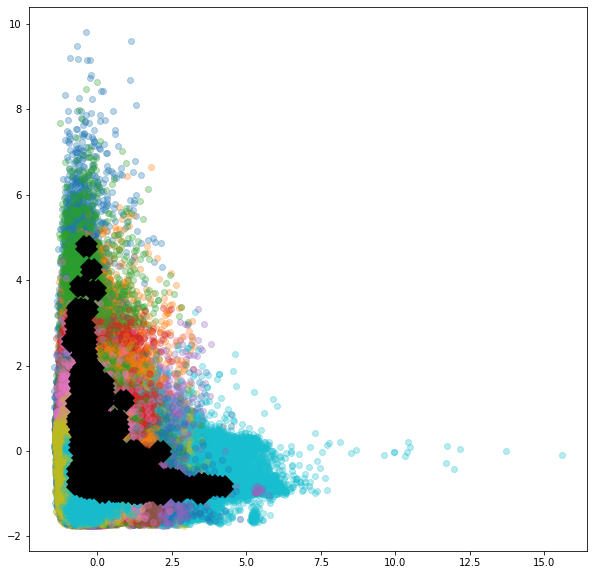

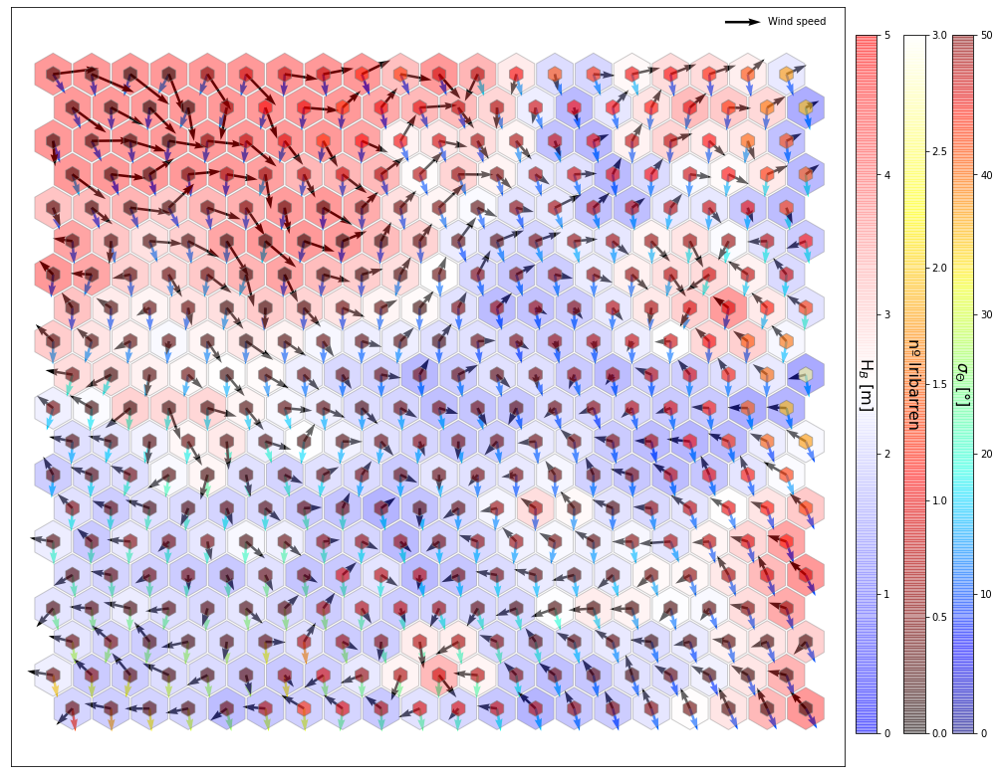

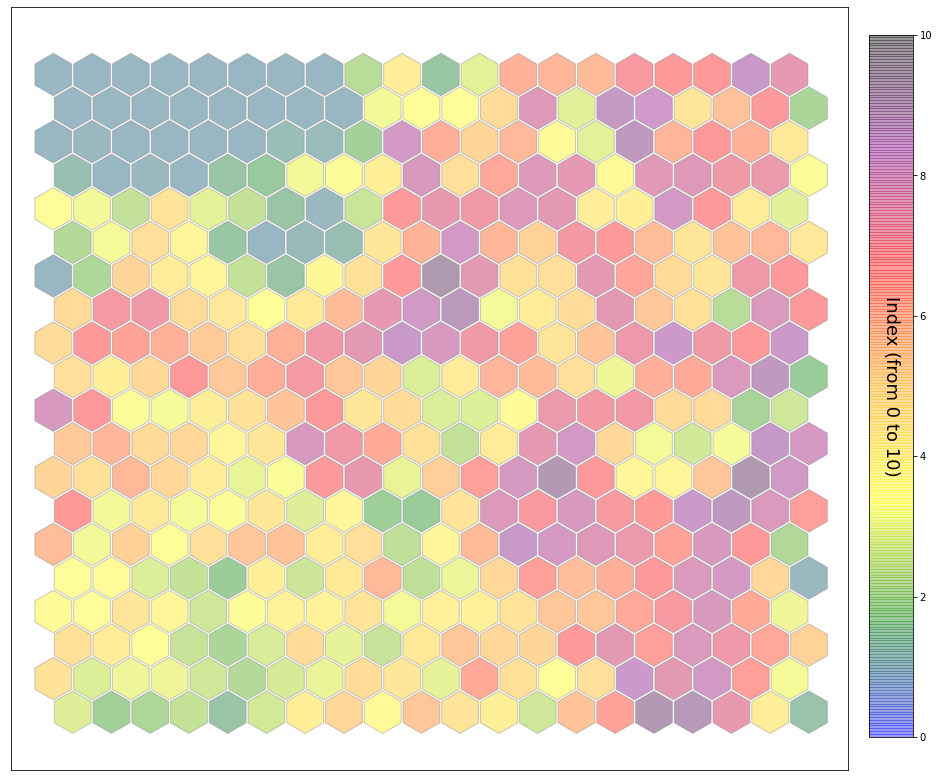

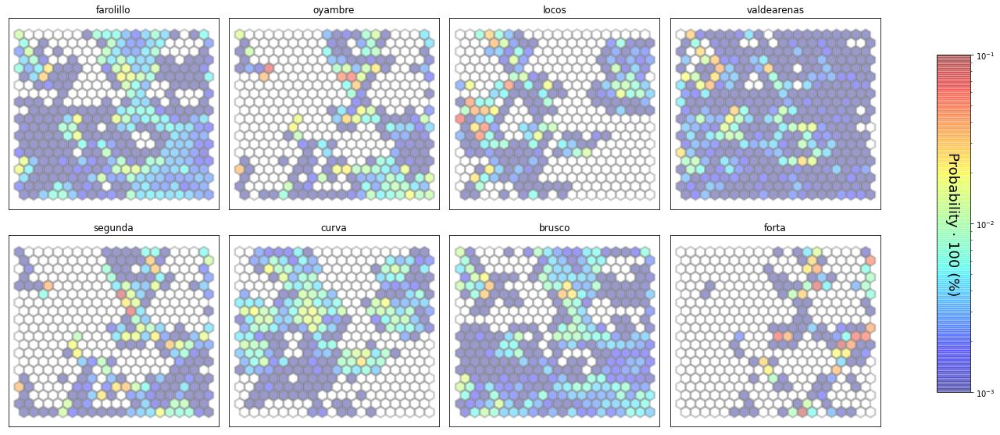

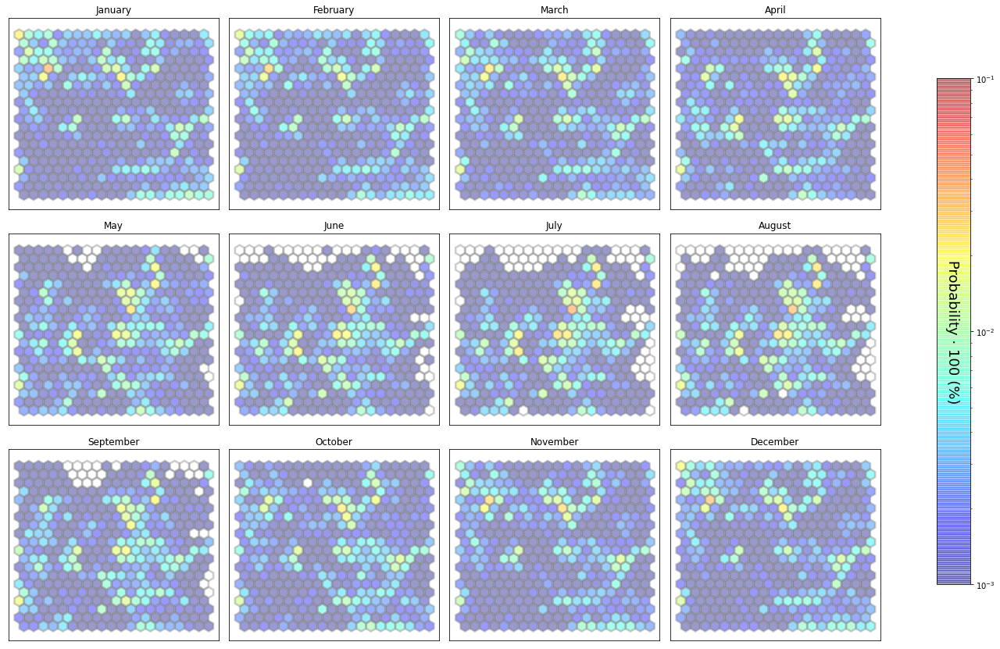

In [18]:
slopes_som = Slopes_SOM(data)
som, data_mean, data_count = slopes_som.train(som_shape=(20,20), sigma=0.8, learning_rate=0.5,
                                              num_iteration=80000, plot_results=True)
slopes_som.plot_results(som, data_mean, data_count, plot_beaches=True, plot_months=True)

The following data will be trained in: farolillo

 
The sum off all probabilities is: 1.0


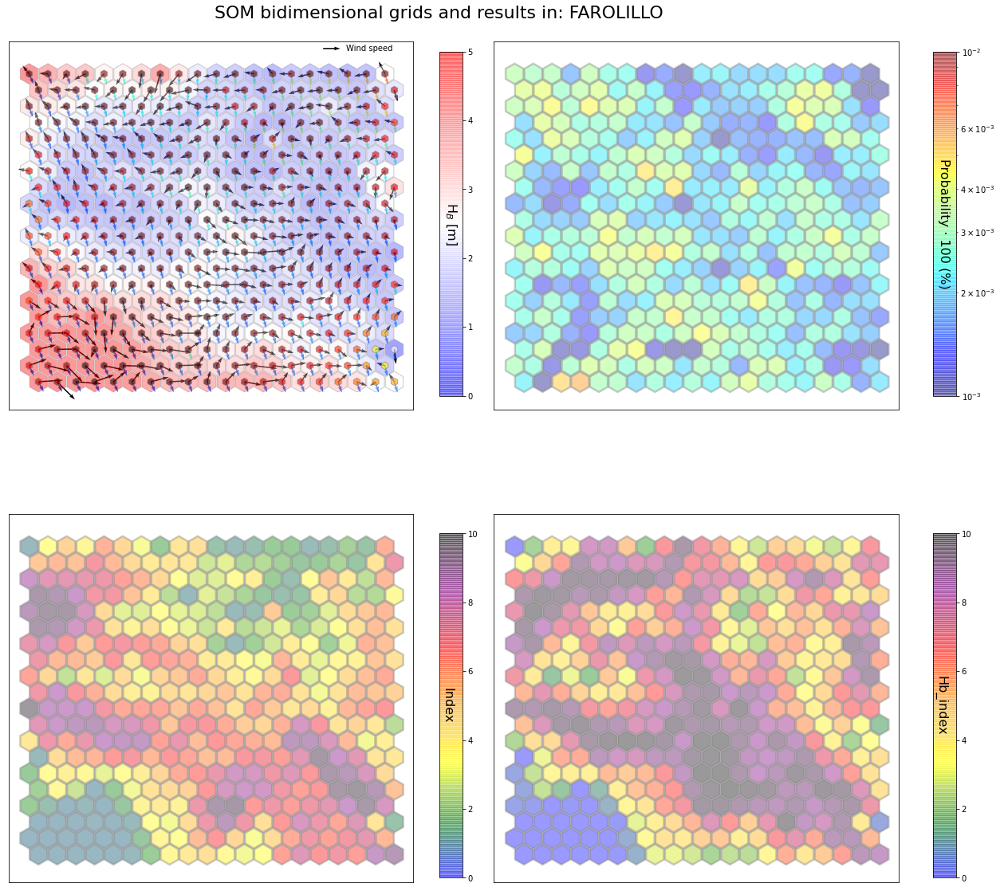

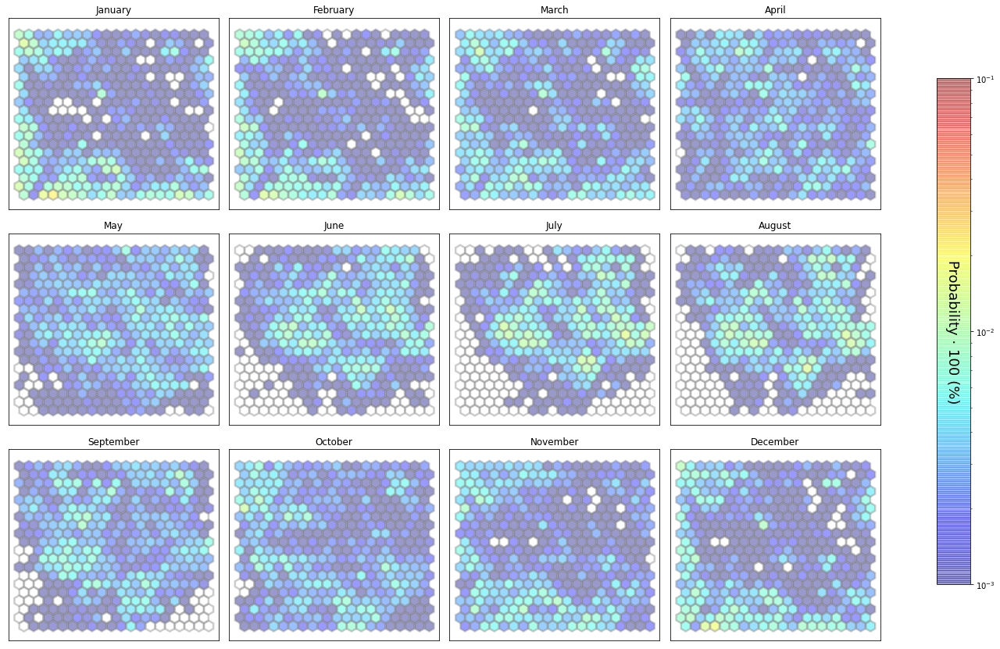

In [19]:
slopes_som = Slopes_SOM(data, beach='farolillo')
som, data_mean, data_count = slopes_som.train(som_shape=(20,20), sigma=0.8, learning_rate=0.5,
                                              num_iteration=50000, plot_results=False)
slopes_som.plot_results(som, data_mean, data_count, second_plot='Hb_index', plot_months=True)

The following data will be trained in: bederna

 
The sum off all probabilities is: 1.0


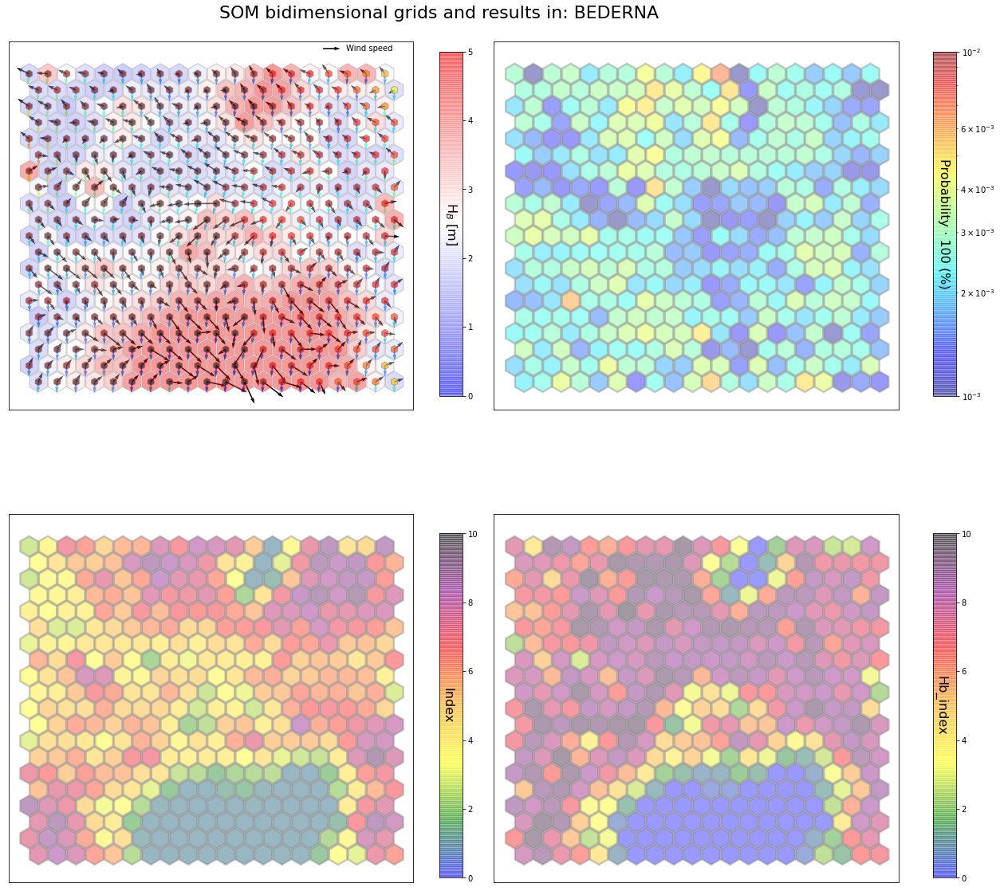

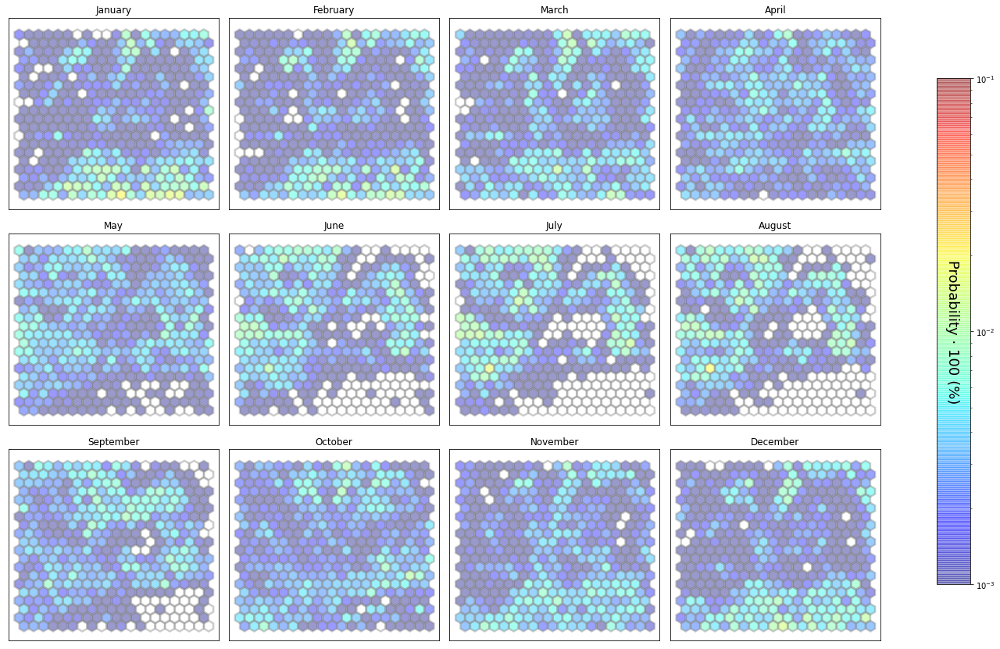

In [20]:
slopes_som = Slopes_SOM(data, beach='bederna')
som, data_mean, data_count = slopes_som.train(som_shape=(20,20), sigma=0.8, learning_rate=0.5,
                                              num_iteration=50000, plot_results=False)
slopes_som.plot_results(som, data_mean, data_count, second_plot='Hb_index', plot_months=True)

The following data will be trained in: oyambre

 
The sum off all probabilities is: 1.0


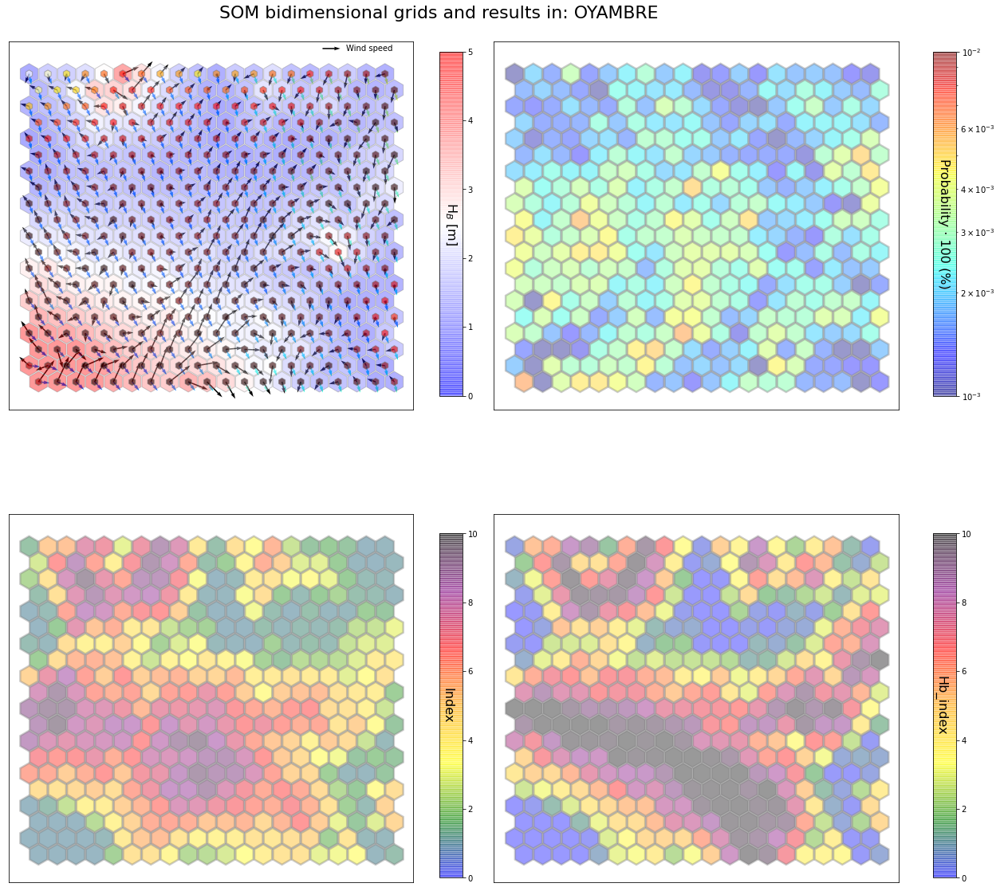

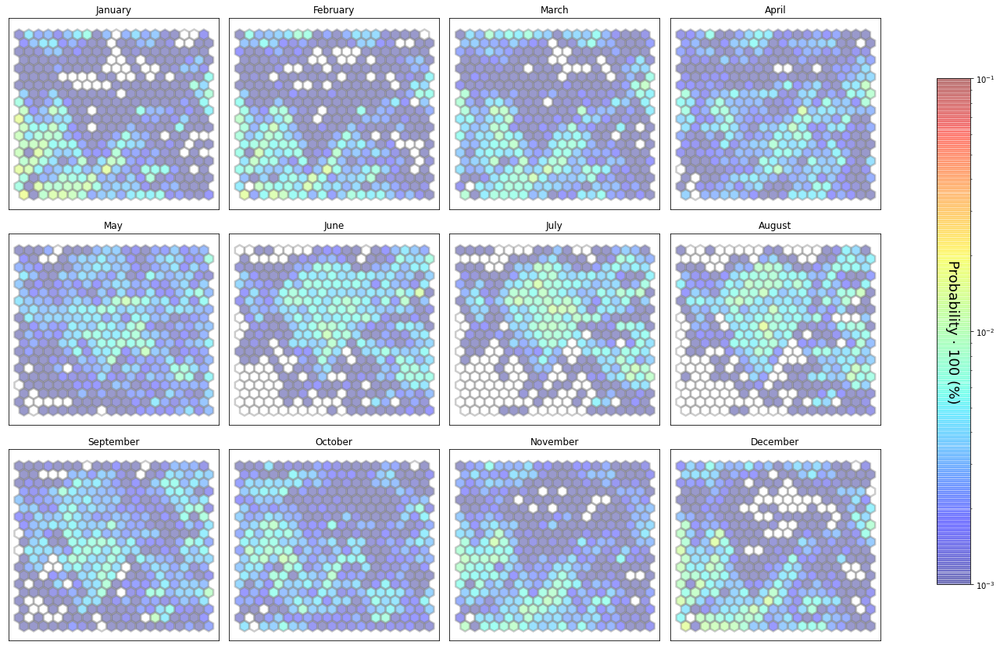

In [21]:
slopes_som = Slopes_SOM(data, beach='oyambre')
som, data_mean, data_count = slopes_som.train(som_shape=(20,20), sigma=0.8, learning_rate=0.5,
                                              num_iteration=50000, plot_results=False)
slopes_som.plot_results(som, data_mean, data_count, second_plot='Hb_index', plot_months=True)

The following data will be trained in: locos

 
The sum off all probabilities is: 0.9999999999999999


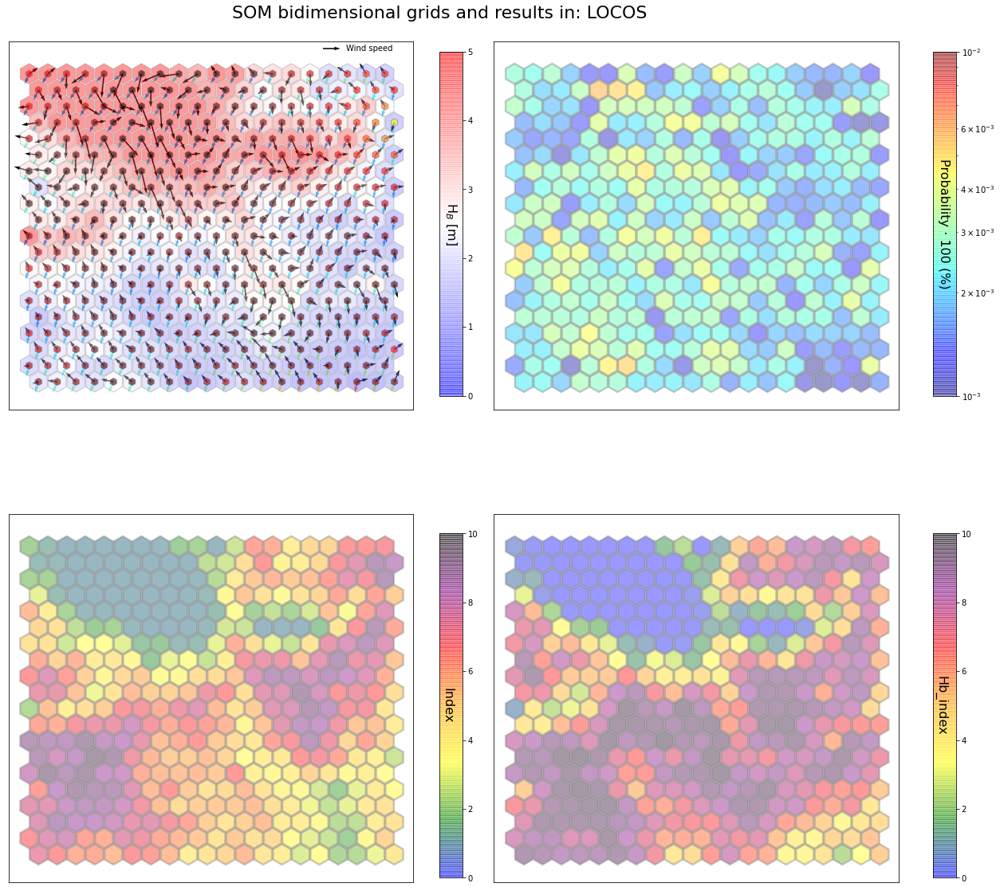

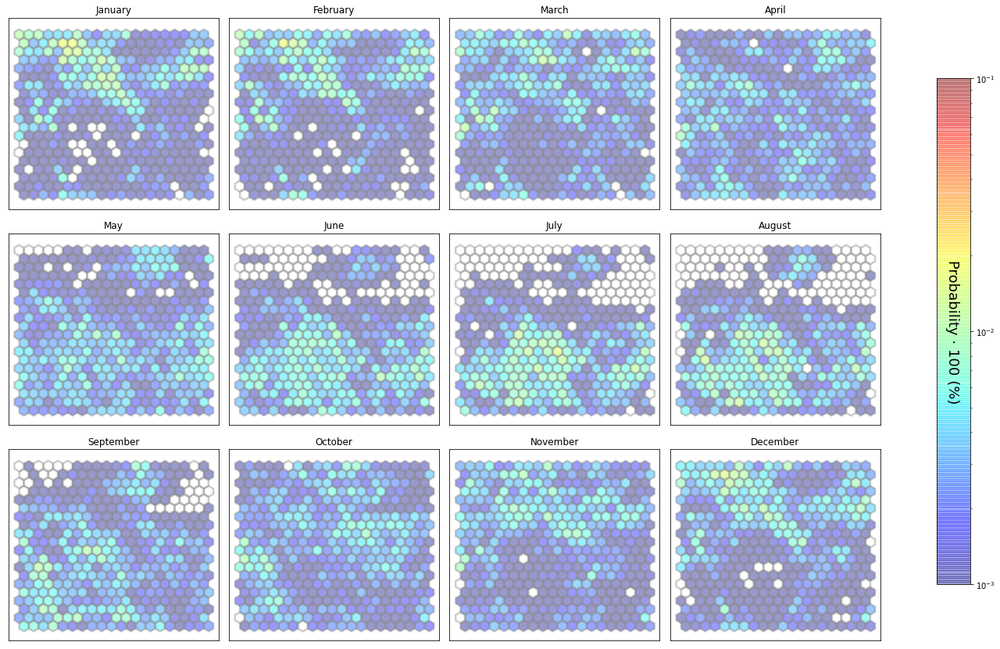

In [22]:
slopes_som = Slopes_SOM(data, beach='locos')
som, data_mean, data_count = slopes_som.train(som_shape=(20,20), sigma=0.8, learning_rate=0.5,
                                              num_iteration=50000, plot_results=False)
slopes_som.plot_results(som, data_mean, data_count, second_plot='Hb_index', plot_months=True)

The following data will be trained in: valdearenas

 
The sum off all probabilities is: 1.0


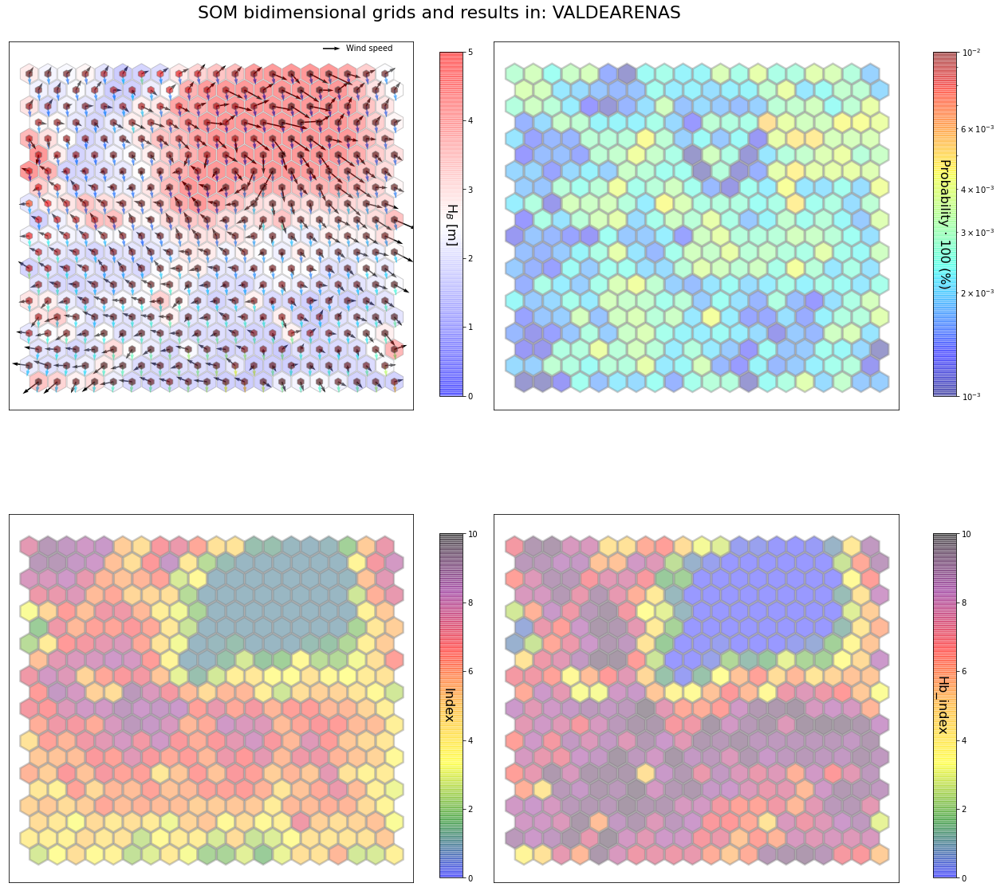

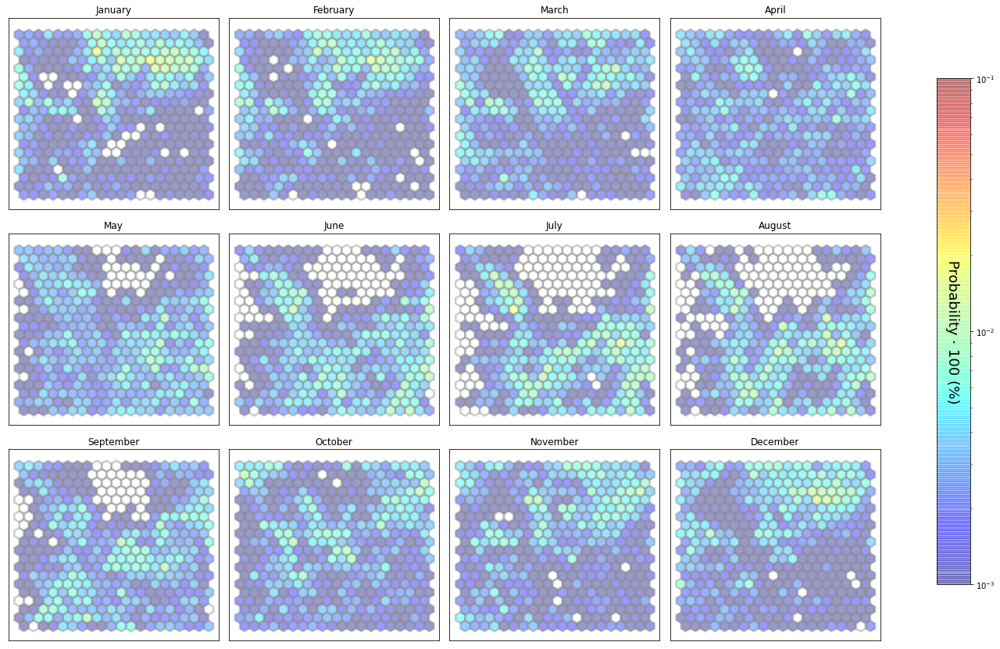

In [23]:
slopes_som = Slopes_SOM(data, beach='valdearenas')
som, data_mean, data_count = slopes_som.train(som_shape=(20,20), sigma=0.8, learning_rate=0.5,
                                              num_iteration=50000, plot_results=False)
slopes_som.plot_results(som, data_mean, data_count, second_plot='Hb_index', plot_months=True)

The following data will be trained in: canallave

 
The sum off all probabilities is: 1.0


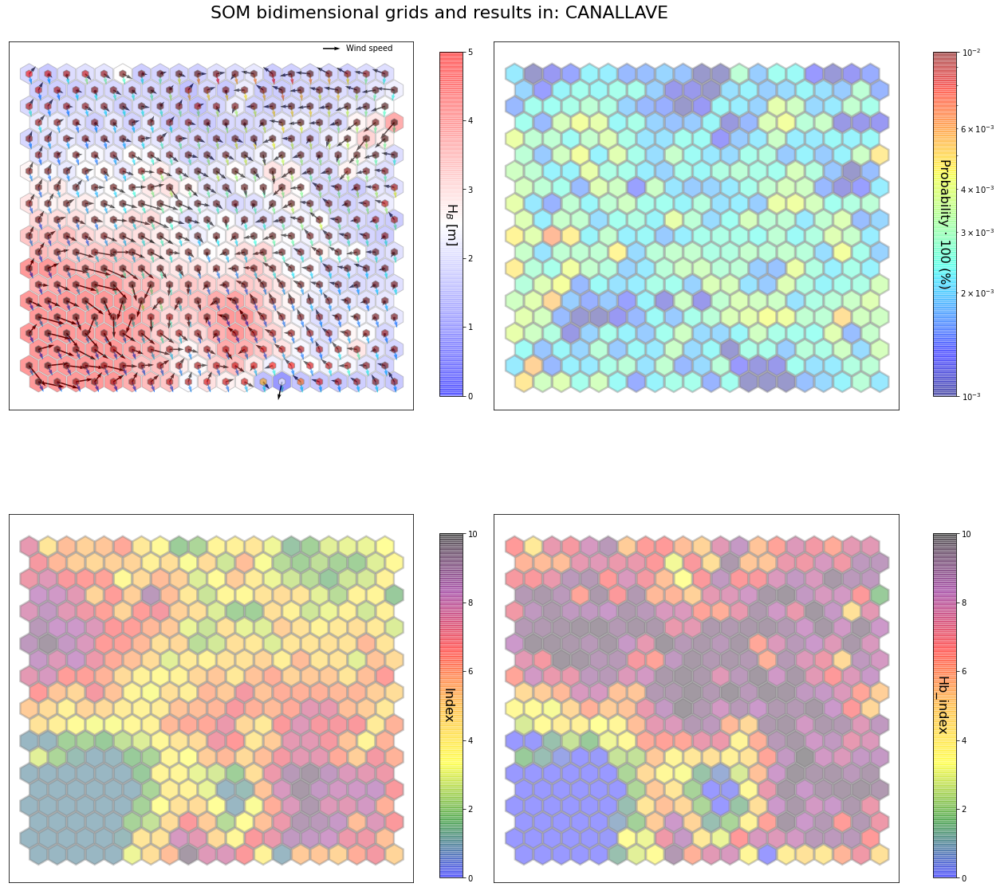

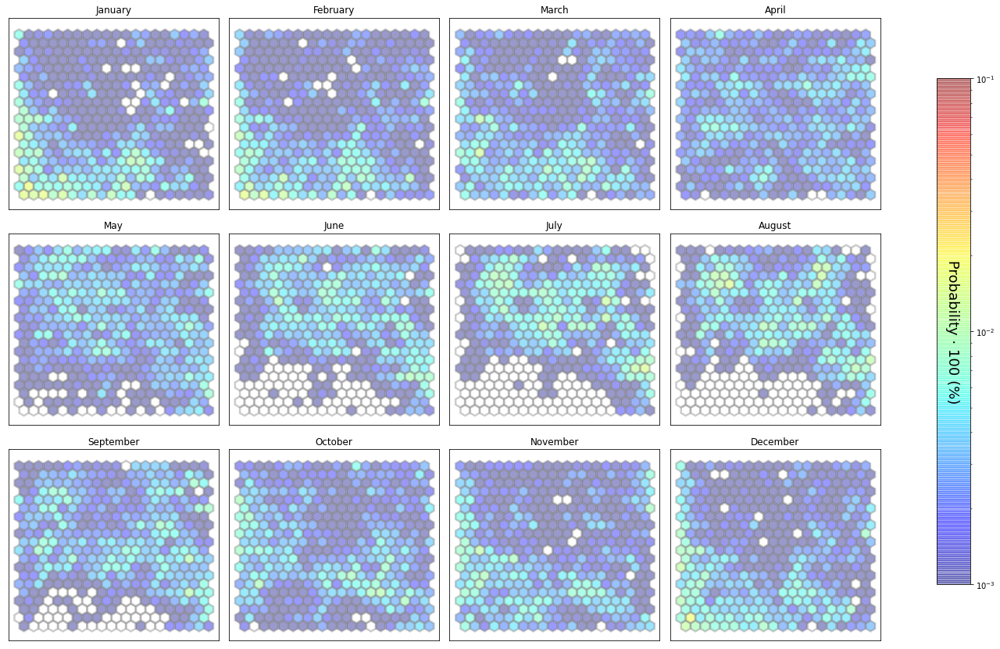

In [24]:
slopes_som = Slopes_SOM(data, beach='canallave')
som, data_mean, data_count = slopes_som.train(som_shape=(20,20), sigma=0.8, learning_rate=0.5,
                                              num_iteration=50000, plot_results=False)
slopes_som.plot_results(som, data_mean, data_count, second_plot='Hb_index', plot_months=True)

The following data will be trained in: madero

 
The sum off all probabilities is: 1.0


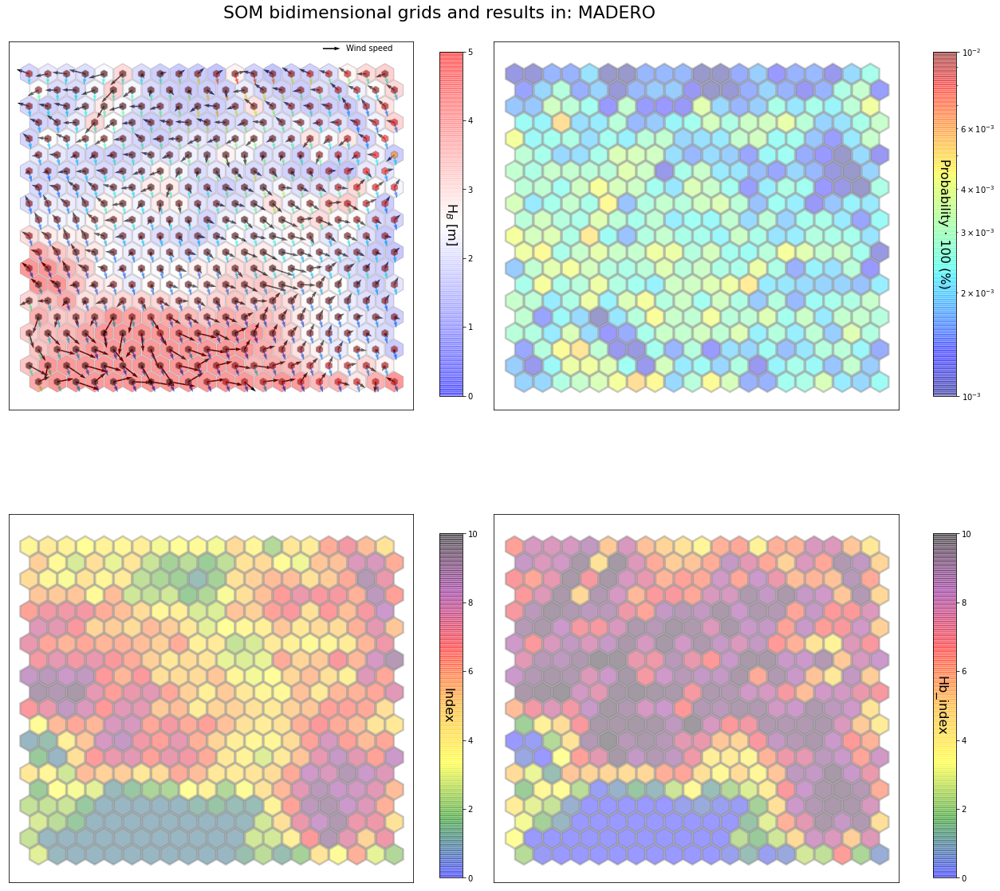

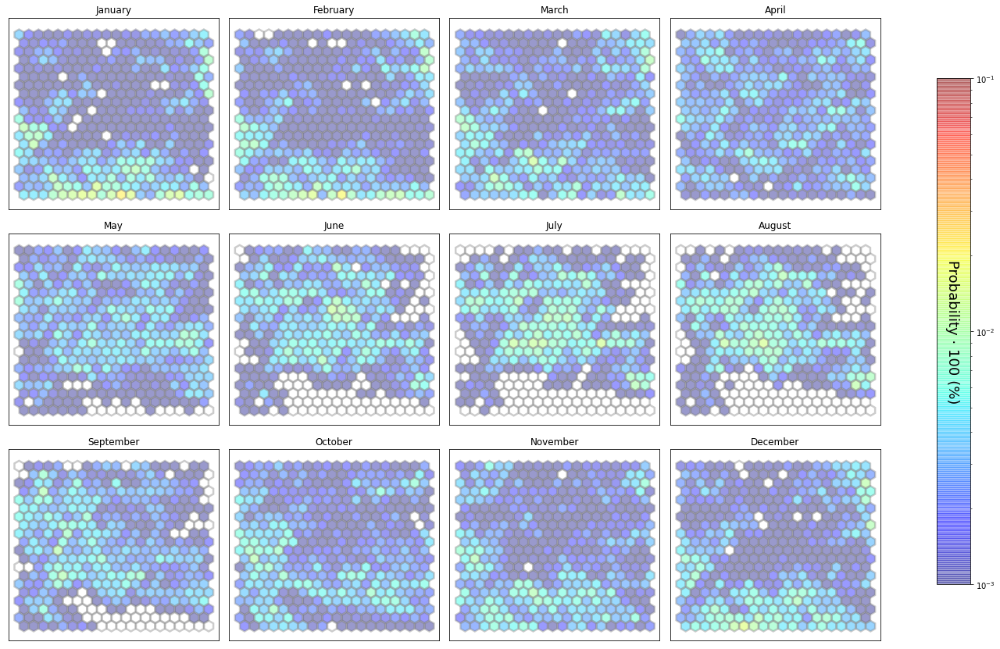

In [25]:
slopes_som = Slopes_SOM(data, beach='madero')
som, data_mean, data_count = slopes_som.train(som_shape=(20,20), sigma=0.8, learning_rate=0.5,
                                              num_iteration=50000, plot_results=False)
slopes_som.plot_results(som, data_mean, data_count, second_plot='Hb_index', plot_months=True)

The following data will be trained in: segunda

 
The sum off all probabilities is: 1.0


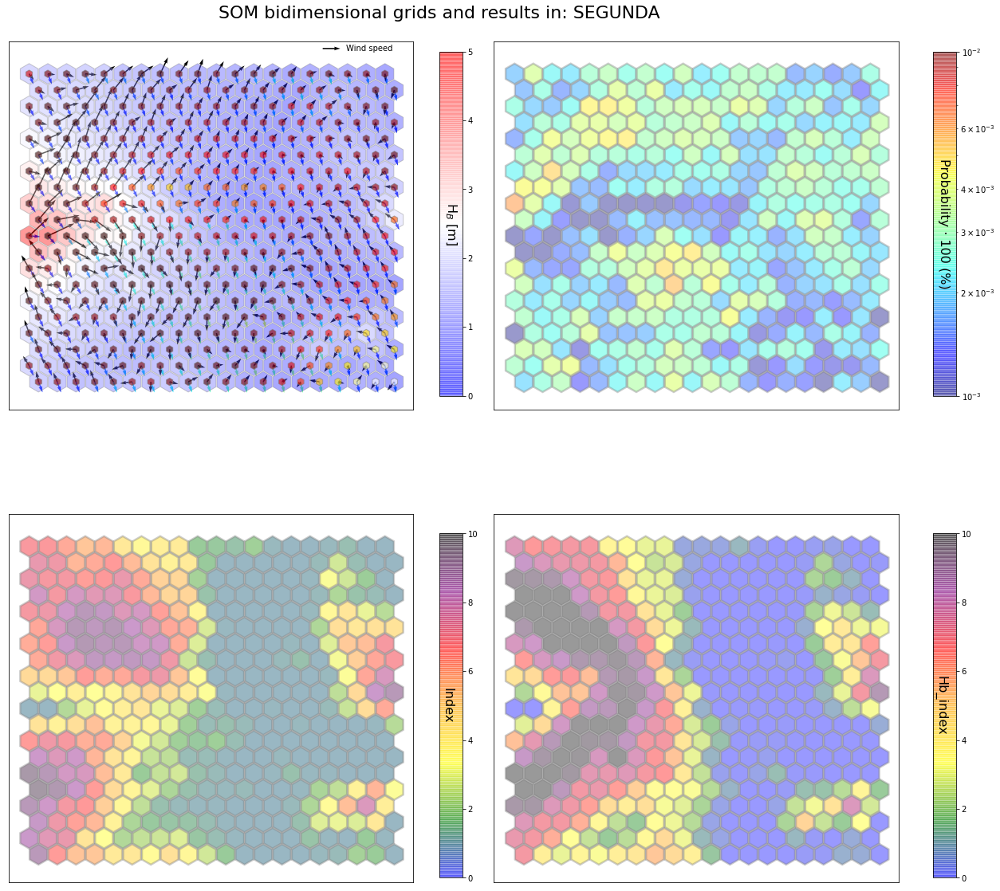

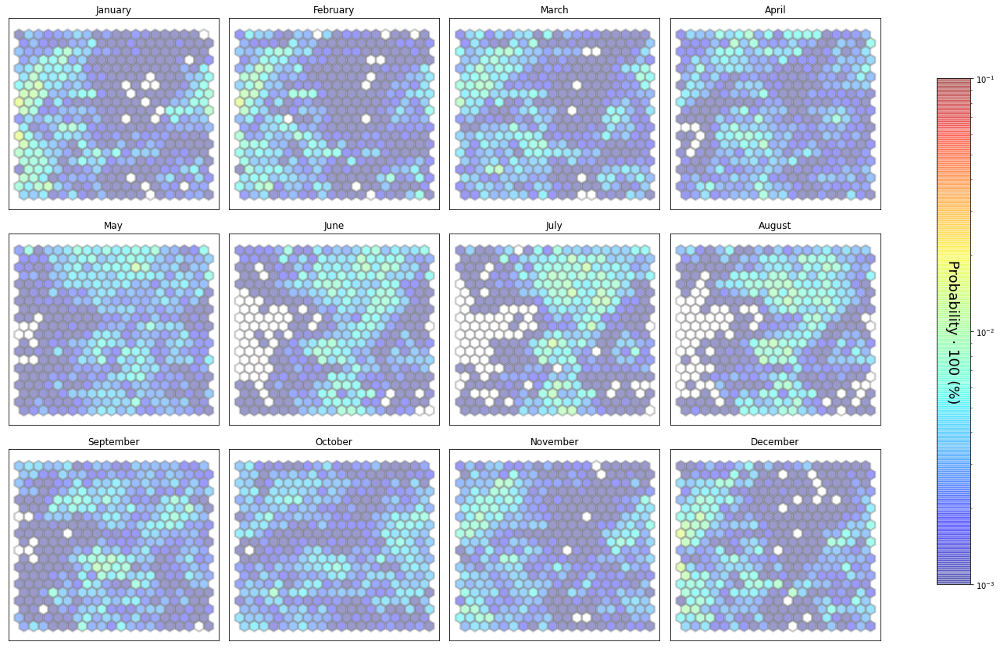

In [26]:
slopes_som = Slopes_SOM(data, beach='segunda')
som, data_mean, data_count = slopes_som.train(som_shape=(20,20), sigma=0.8, learning_rate=0.5,
                                              num_iteration=50000, plot_results=False)
slopes_som.plot_results(som, data_mean, data_count, second_plot='Hb_index', plot_months=True)

The following data will be trained in: primera

 
The sum off all probabilities is: 1.0


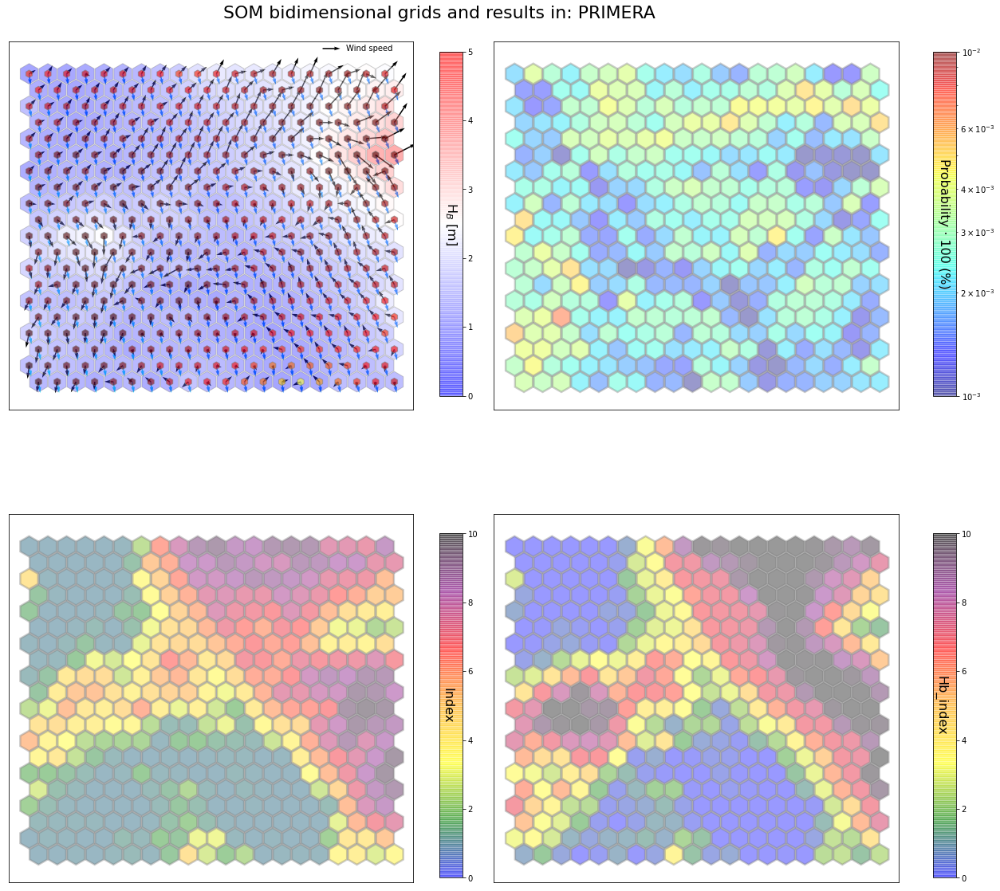

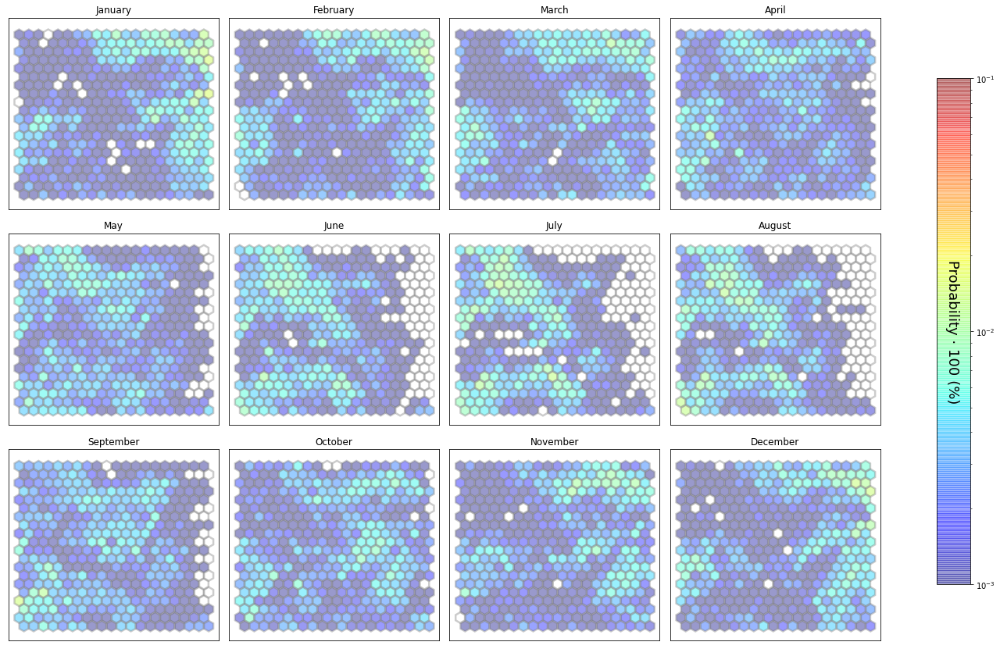

In [27]:
slopes_som = Slopes_SOM(data, beach='primera')
som, data_mean, data_count = slopes_som.train(som_shape=(20,20), sigma=0.8, learning_rate=0.5,
                                              num_iteration=50000, plot_results=False)
slopes_som.plot_results(som, data_mean, data_count, second_plot='Hb_index', plot_months=True)

The following data will be trained in: pueblo

 
The sum off all probabilities is: 1.0


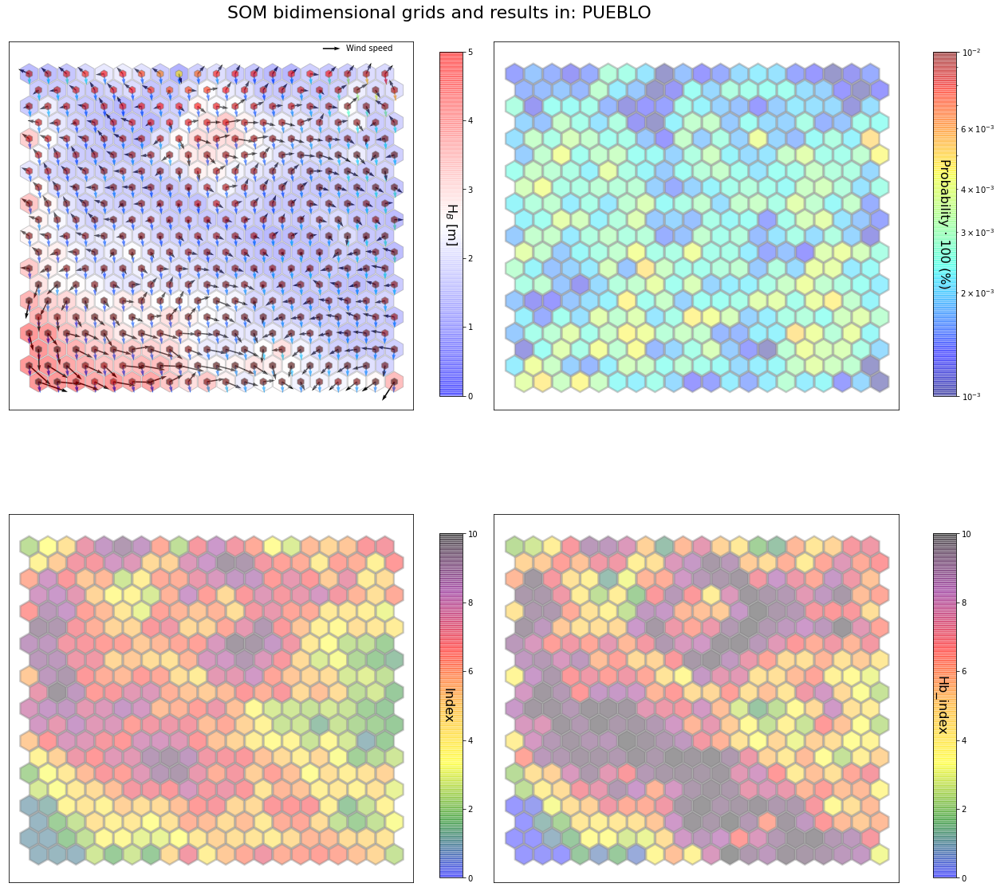

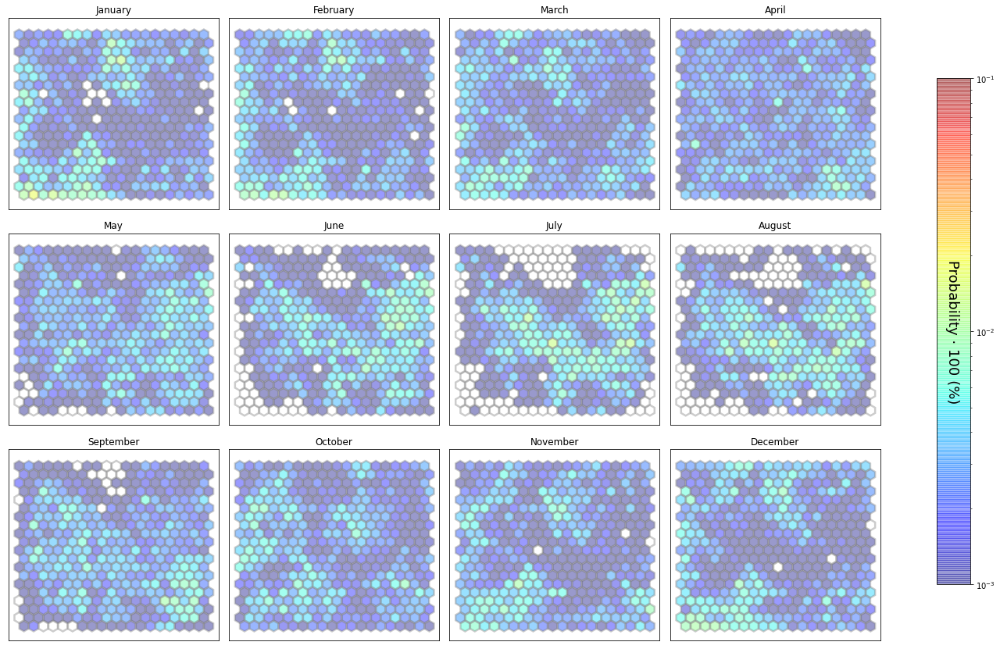

In [28]:
slopes_som = Slopes_SOM(data, beach='pueblo')
som, data_mean, data_count = slopes_som.train(som_shape=(20,20), sigma=0.8, learning_rate=0.5,
                                              num_iteration=50000, plot_results=False)
slopes_som.plot_results(som, data_mean, data_count, second_plot='Hb_index', plot_months=True)

The following data will be trained in: curva

 
The sum off all probabilities is: 1.0


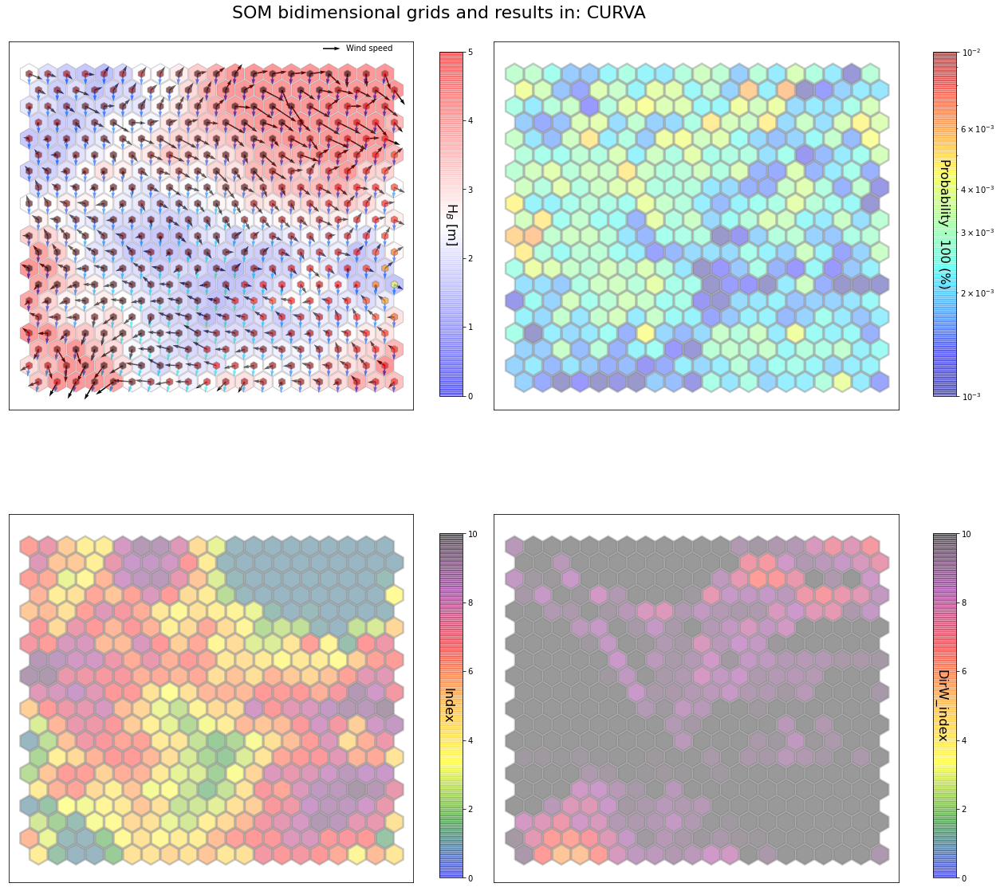

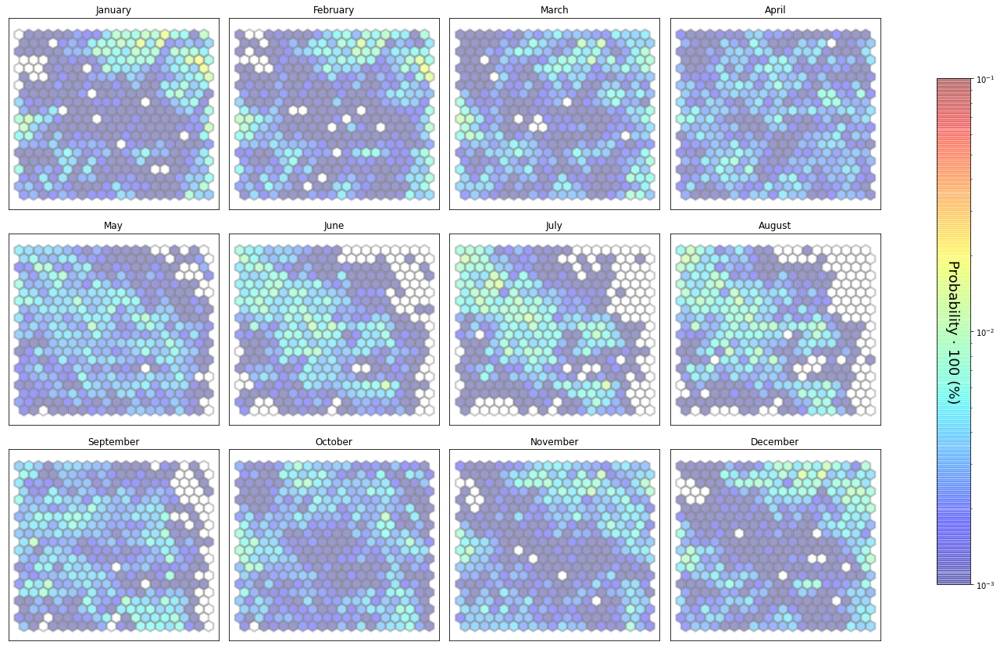

In [29]:
slopes_som = Slopes_SOM(data, beach='curva')
som, data_mean, data_count = slopes_som.train(som_shape=(20,20), sigma=0.8, learning_rate=0.5,
                                              num_iteration=50000, plot_results=False)
slopes_som.plot_results(som, data_mean, data_count, second_plot='DirW_index', plot_months=True)

The following data will be trained in: brusco

 
The sum off all probabilities is: 1.0


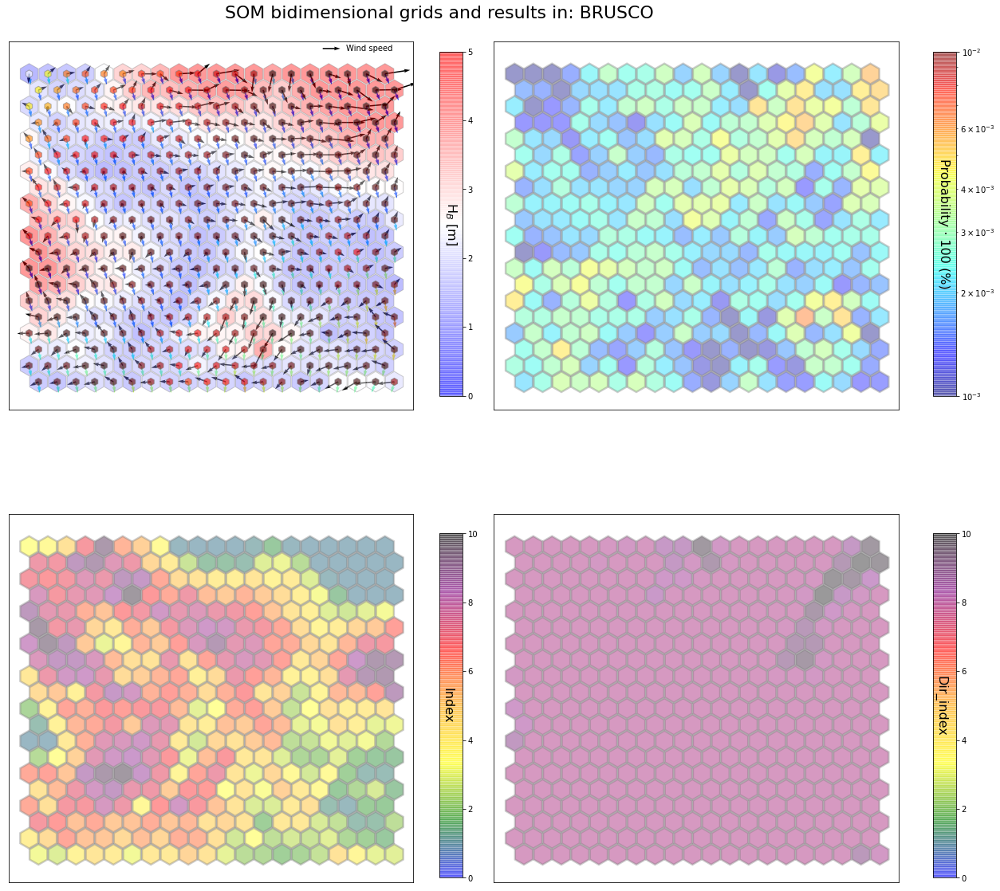

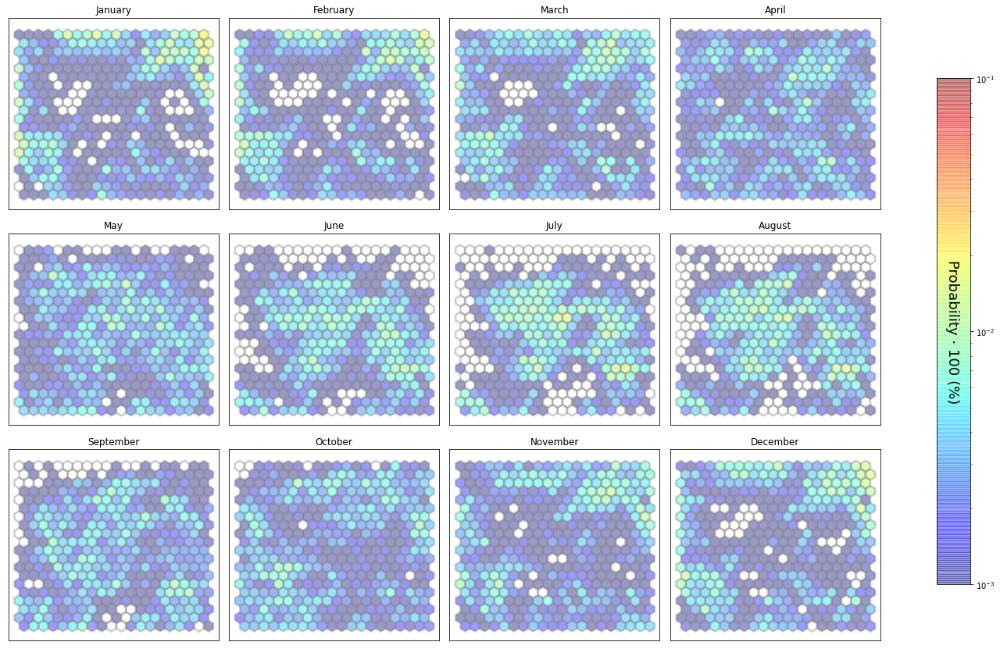

In [30]:
slopes_som = Slopes_SOM(data, beach='brusco')
som, data_mean, data_count = slopes_som.train(som_shape=(20,20), sigma=0.8, learning_rate=0.5,
                                              num_iteration=50000, plot_results=False)
slopes_som.plot_results(som, data_mean, data_count, second_plot='Dir_index', plot_months=True)

The following data will be trained in: forta

 
The sum off all probabilities is: 1.0


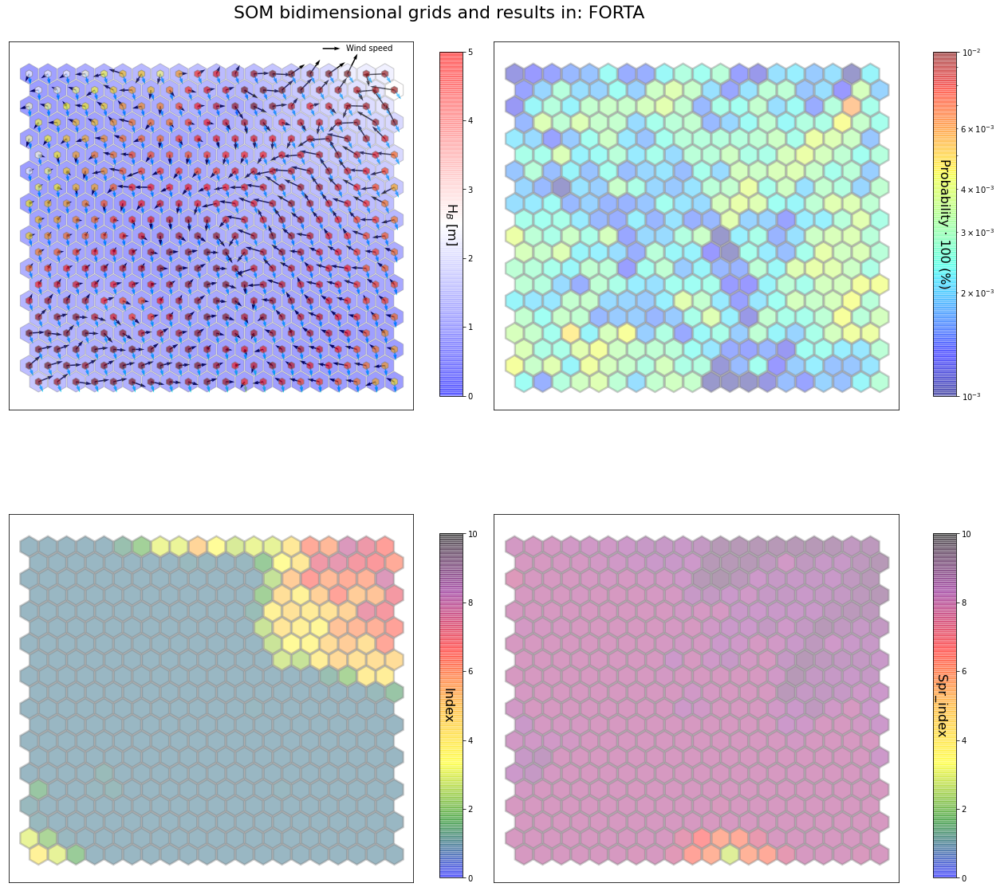

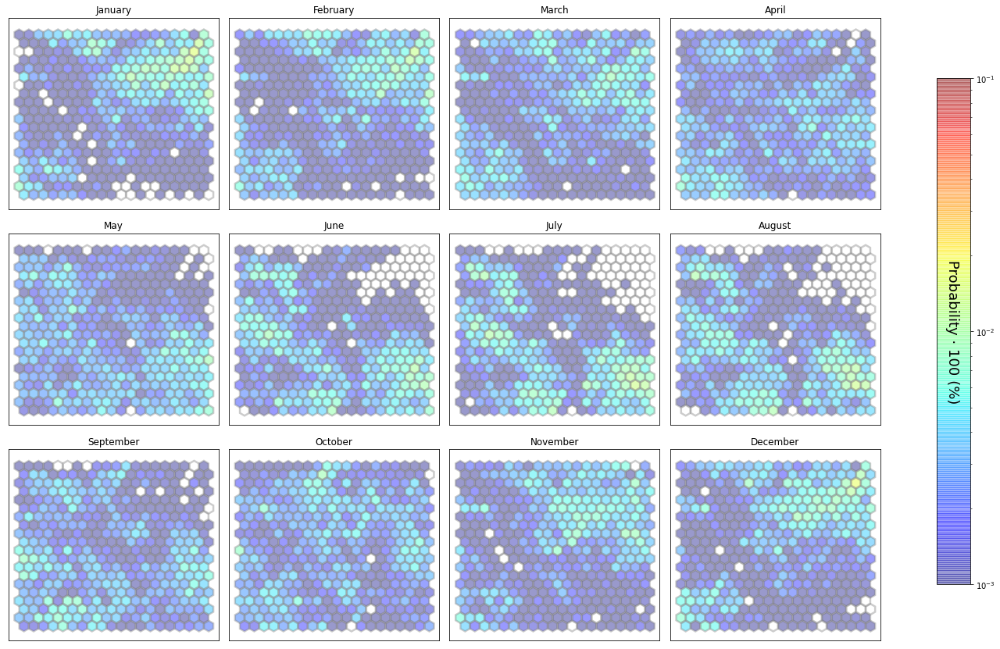

In [31]:
slopes_som = Slopes_SOM(data, beach='forta')
som, data_mean, data_count = slopes_som.train(som_shape=(20,20), sigma=0.8, learning_rate=0.5,
                                              num_iteration=50000, plot_results=False)
slopes_som.plot_results(som, data_mean, data_count, second_plot='Spr_index', plot_months=True)

The following data will be trained in: laredo

 
The sum off all probabilities is: 1.0


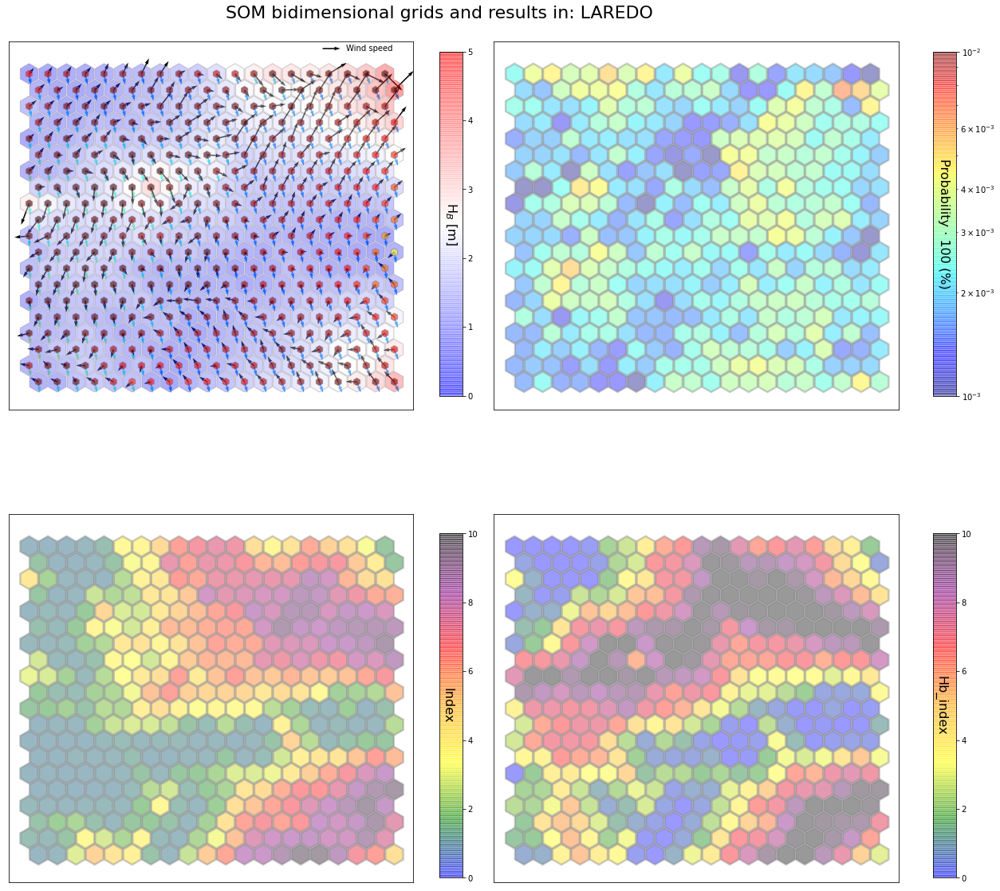

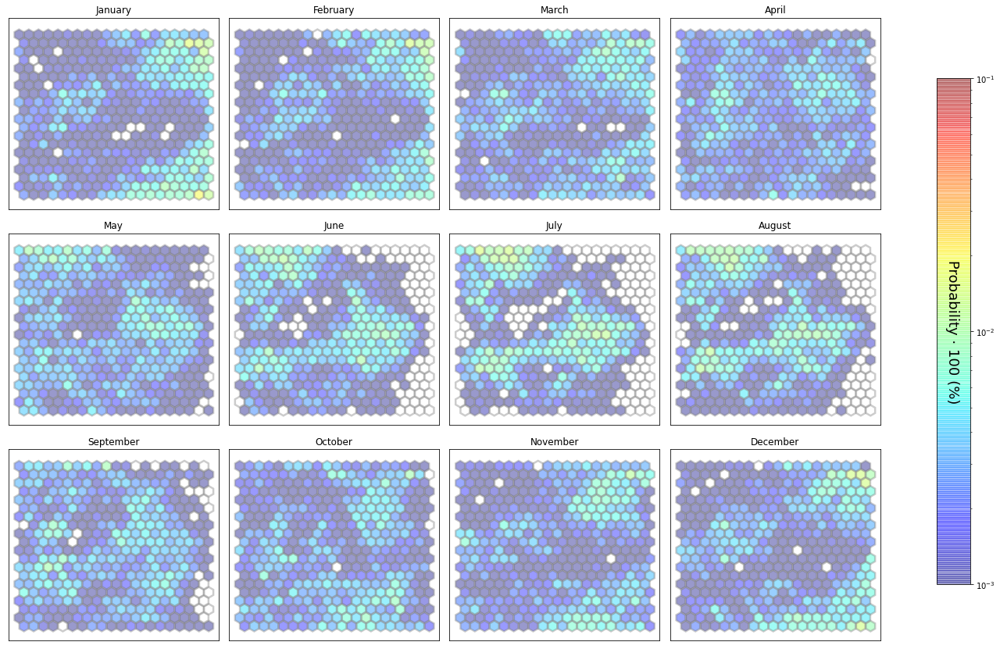

In [32]:
slopes_som = Slopes_SOM(data, beach='laredo')
som, data_mean, data_count = slopes_som.train(som_shape=(20,20), sigma=0.8, learning_rate=0.5,
                                              num_iteration=50000, plot_results=False)
slopes_som.plot_results(som, data_mean, data_count, second_plot='Hb_index', plot_months=True)